In [21]:
import os
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import numpy as np
from PIL import Image
from scipy.spatial import ConvexHull, convex_hull_plot_2d

input_directory_name = 'InputFolder/'
output_directory_name = 'OutputFolder/'

[[1 2 3]
 [4 5 6]]


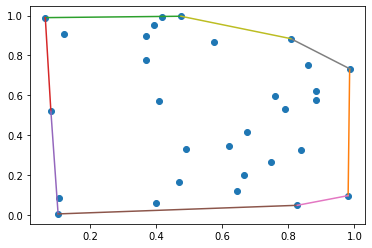

In [38]:
points = np.random.rand(30, 2)
hull = ConvexHull(points)

plt.plot(points[:,0],points[:,1],'o')
for simplex in hull.simplices:
    plt.plot(points[simplex, 0], points[simplex, 1])

In [89]:
def readData(input_directory_name, input_network):
    f = open(input_directory_name + input_network.name, "r")
    Lines = f.readlines()[3:]
    f.close()
    return Lines

In [90]:
def formatData(Lines):
    A = []
    bracket = "{"
    for i in range(0, len(Lines)):
        if not bracket in Lines[i]:
            node = Lines[i].partition("|")[0] # get the node
            degree = int(Lines[i][-2]) # how many edges does this node have?
            B = [0]*(degree+1)
            B[0] = node
            k = 1
            for j in range(i + 1, i + degree + 1): # get all the edges of the node
                edge = Lines[j].partition("|")[0]
                B[k] = edge
                k += 1
            A.append(B)
    return A

In [91]:
def findHullPoints(A):
    tmpArray = []
    for B in A:
        for b in B:
            b = list(tuple(map(int, b[1:-1].split(','))))
            tmpArray.append(b)
    hullPoints = np.array(tmpArray)
    return hullPoints

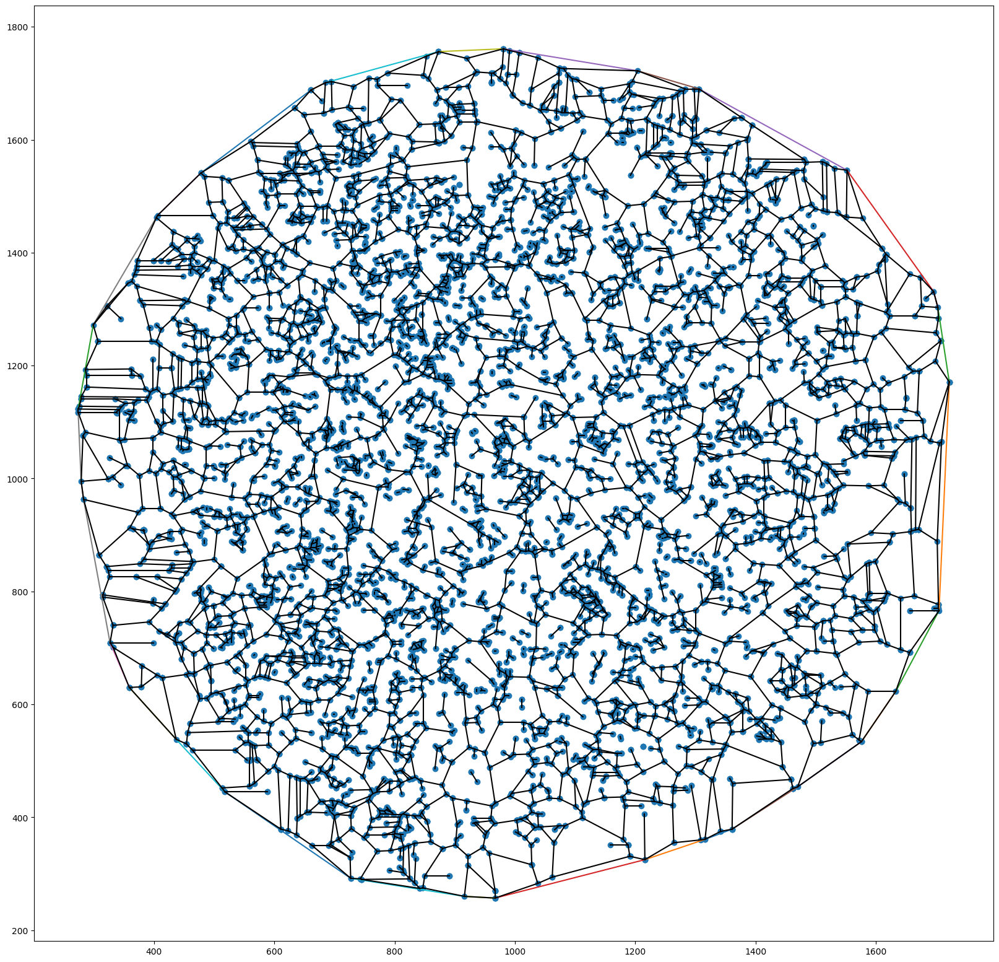

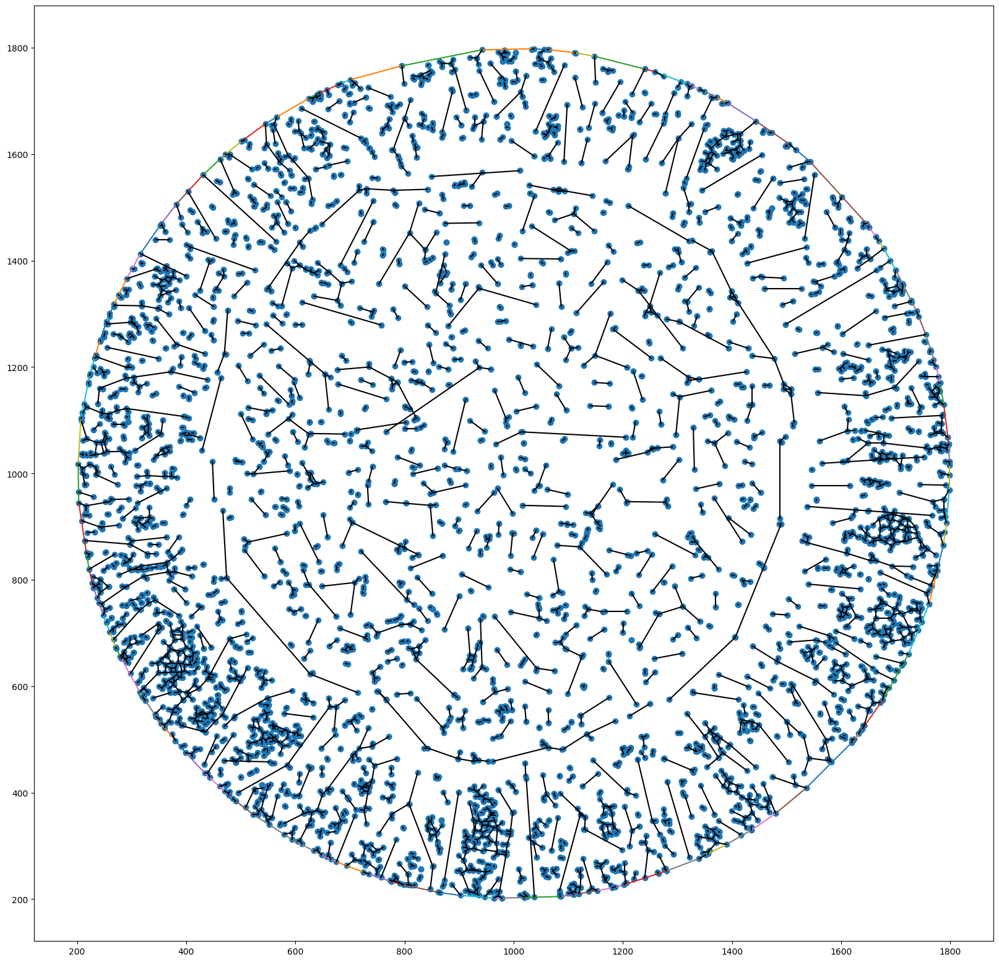

In [94]:
with os.scandir(input_directory_name) as input_networks:
    for input_network in input_networks:
        # read text files
        Lines = readData(input_directory_name, input_network)
        # reformat data
        A = formatData(Lines)
        # find hull
        hullPoints = findHullPoints(A)
        hull = ConvexHull(hullPoints)
        
        figure(num=None, figsize=(20, 20), dpi=100)
        plt.plot(hullPoints[:,0],hullPoints[:,1],'o')
        for simplex in hull.simplices:
            plt.plot(hullPoints[simplex, 0], hullPoints[simplex, 1])
        # draw the network
        #figure(num=None, figsize=(20, 20), dpi=100)
        
        X = []
        Y = []
        for j in range(0, len(A)):
            C = A[j]
            k = C[0].find(',')
            x1 = int(C[0][1:].partition(",")[0]) # get the coordinates of the main node
            y1 = int(C[0][k+2:].partition(")")[0])
            X.append(x1)
            Y.append(y1)
            for i in range(1, len(C)):
                k = C[i].find(',')
                x2 = int(C[i][1:].partition(",")[0]) # get the coordinates of the destination node
                y2 = int(C[i][k + 2:].partition(")")[0])
                X.append(x2)
                Y.append(y2)
                plt.plot([x1,x2], [y1,y2],'k-')  # plot the edge
        plt.scatter(X, Y, 3) # plot EVERY node
        #plt.axis('off')
        plt.savefig(output_directory_name + input_network.name[:-3] + 'png')

# close the text files
input_networks.close()

In [9]:
import os

# used for drawing network
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import numpy as np
from PIL import Image

nefi_text_directory_name = 'Step 4 - NEFI Text Files/'
python_network_directory_name = 'Step 5 - Python Network/'
originalimg_directory_name = 'Step 1 - Resized Raw Bacteria Images/'
overlay_directory_name = 'Step 6 - Overlay/'

In [10]:
# create a new directory
try:
    os.mkdir(python_network_directory_name)
except:
    pass

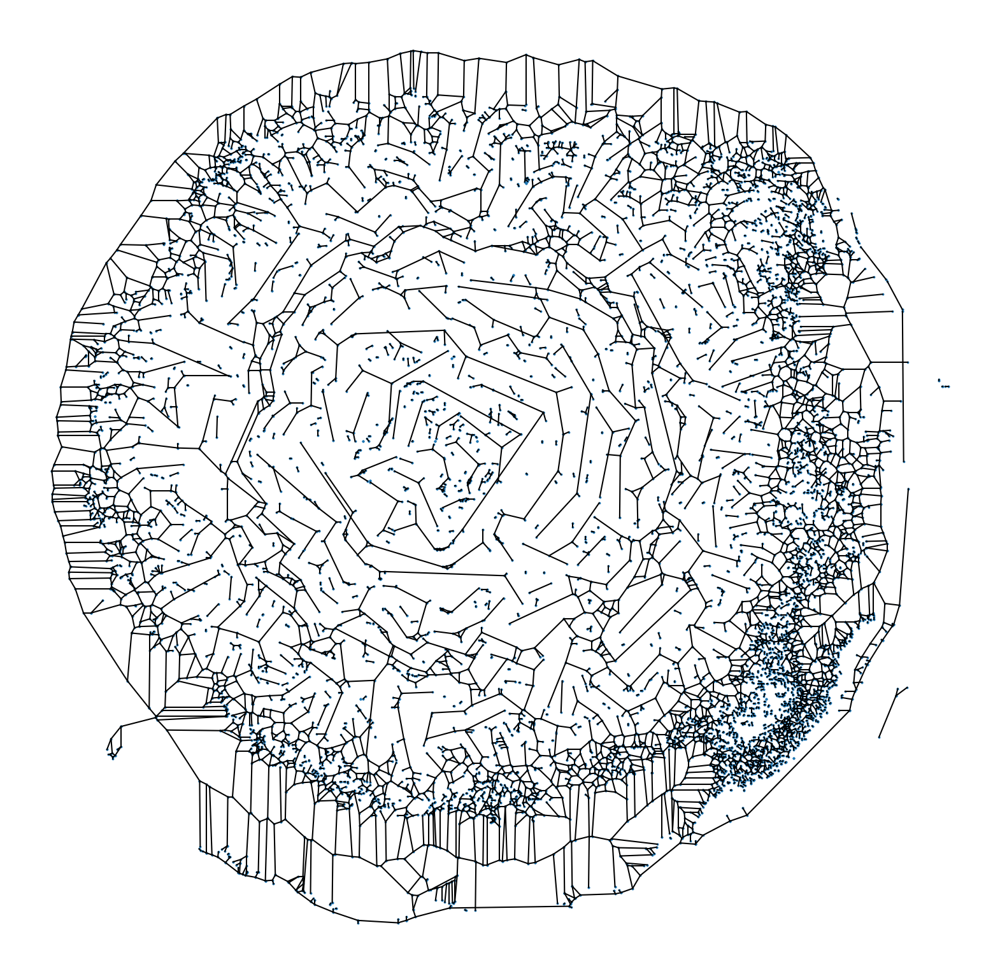

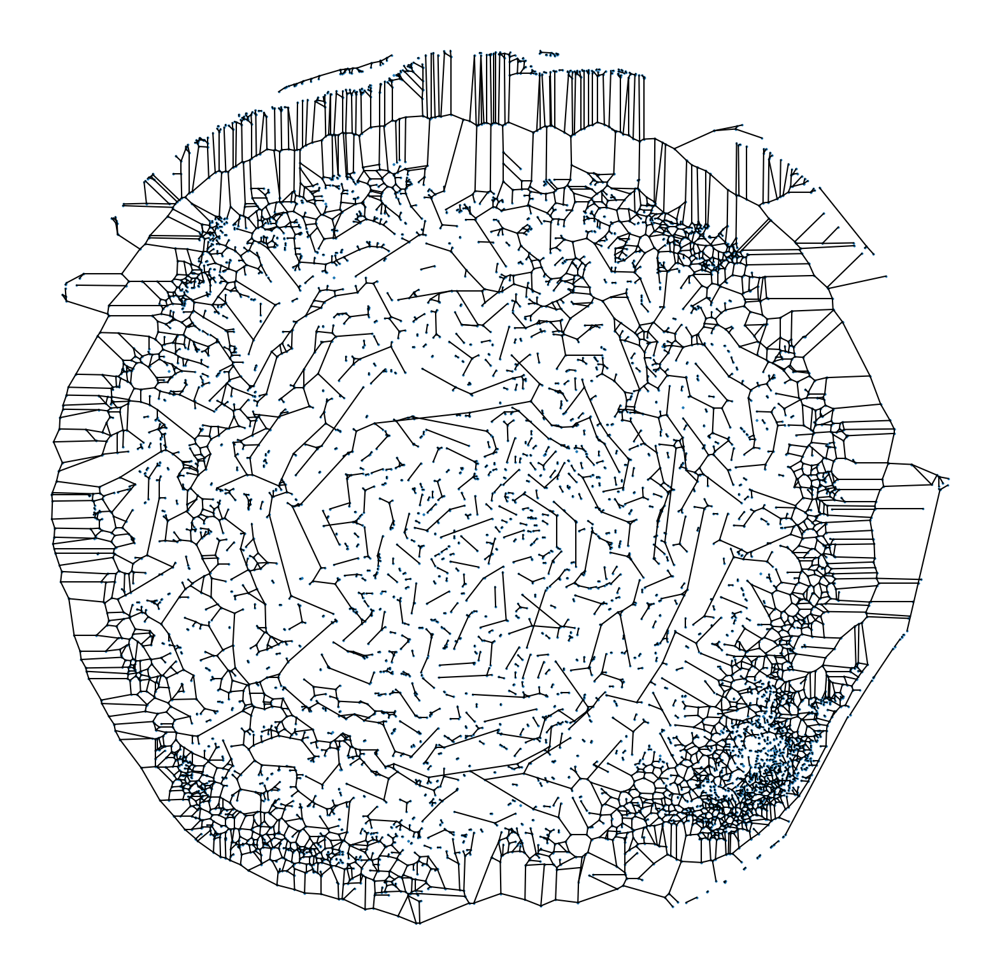

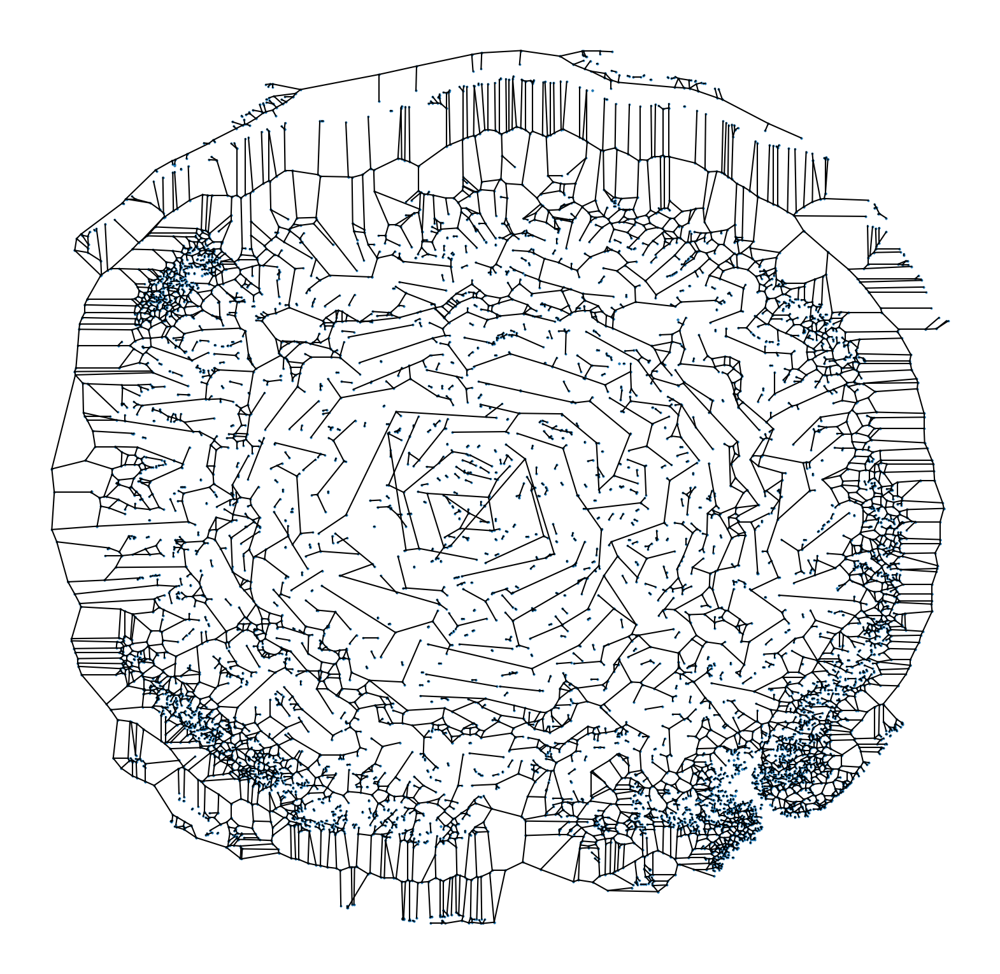

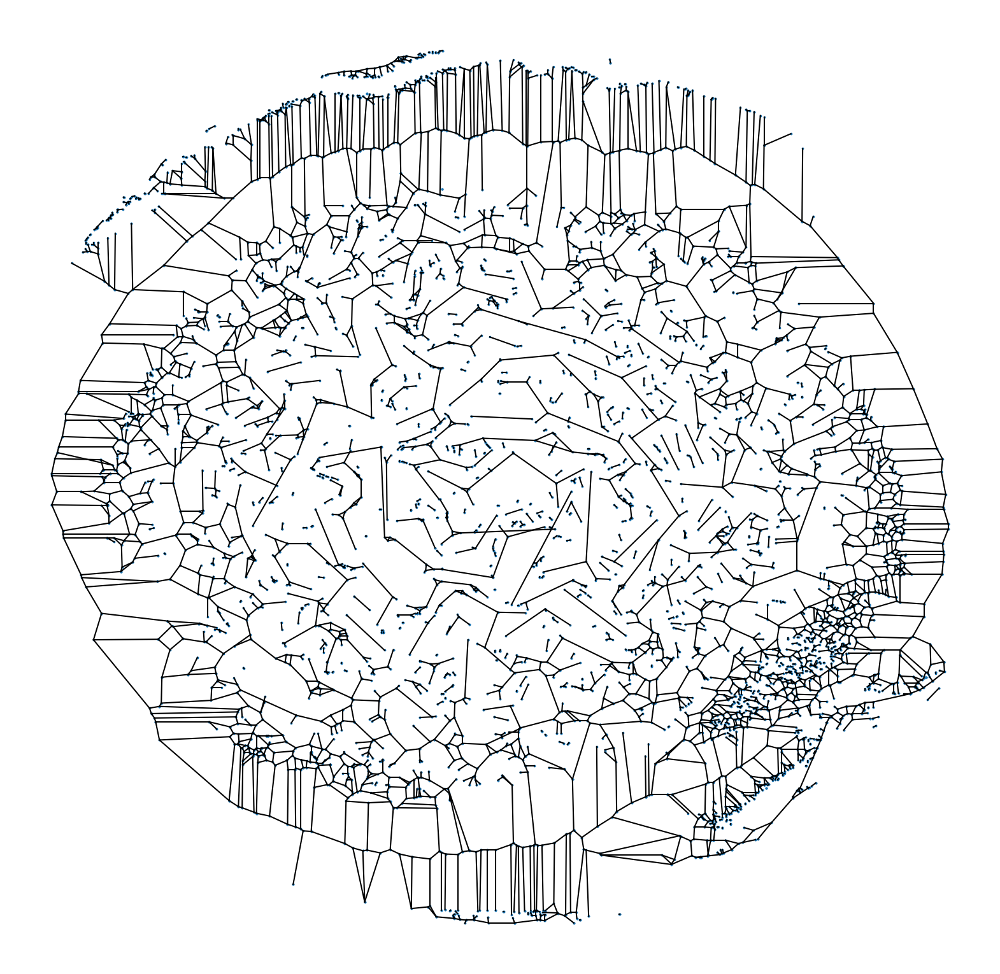

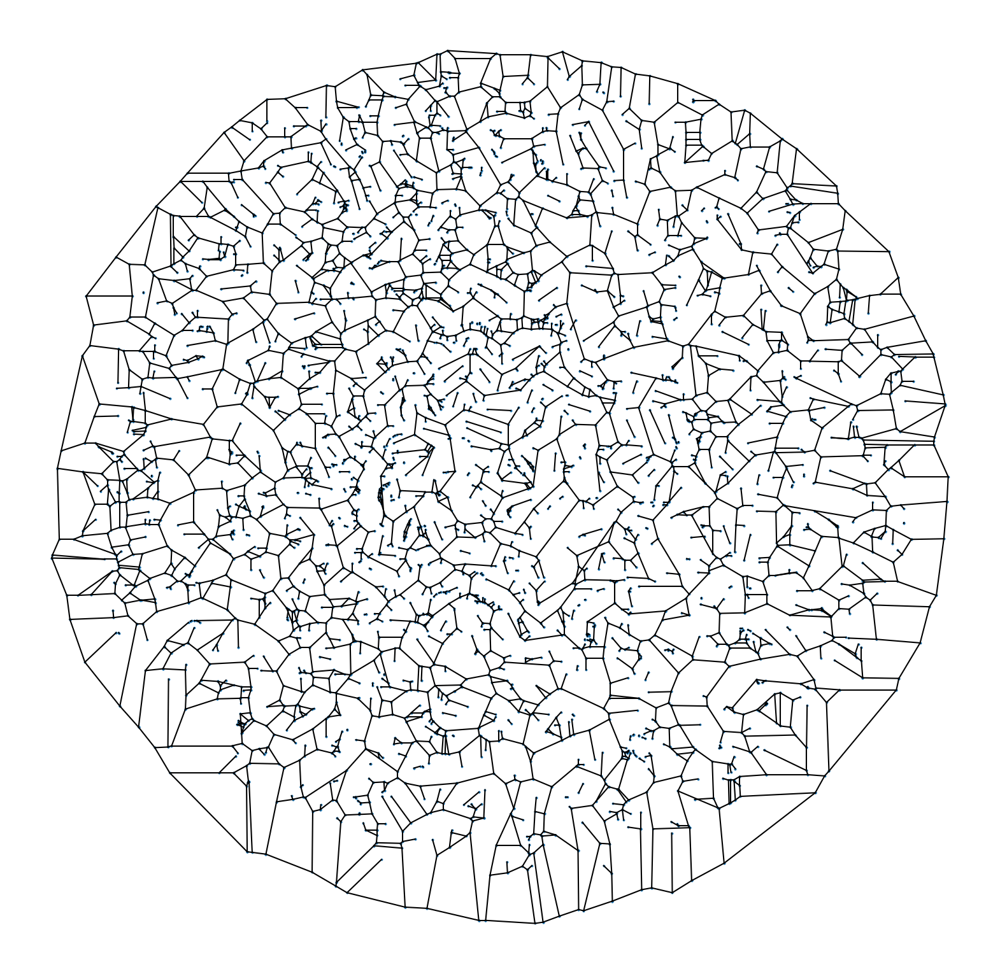

...

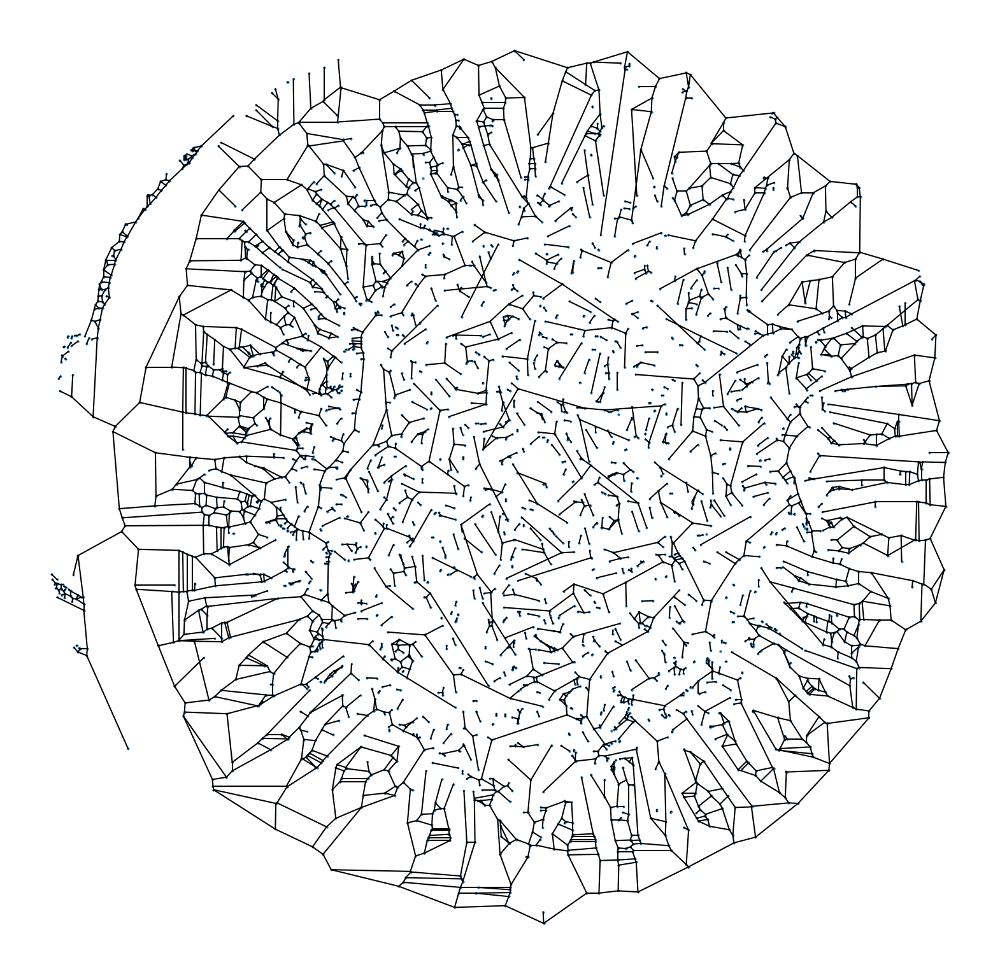

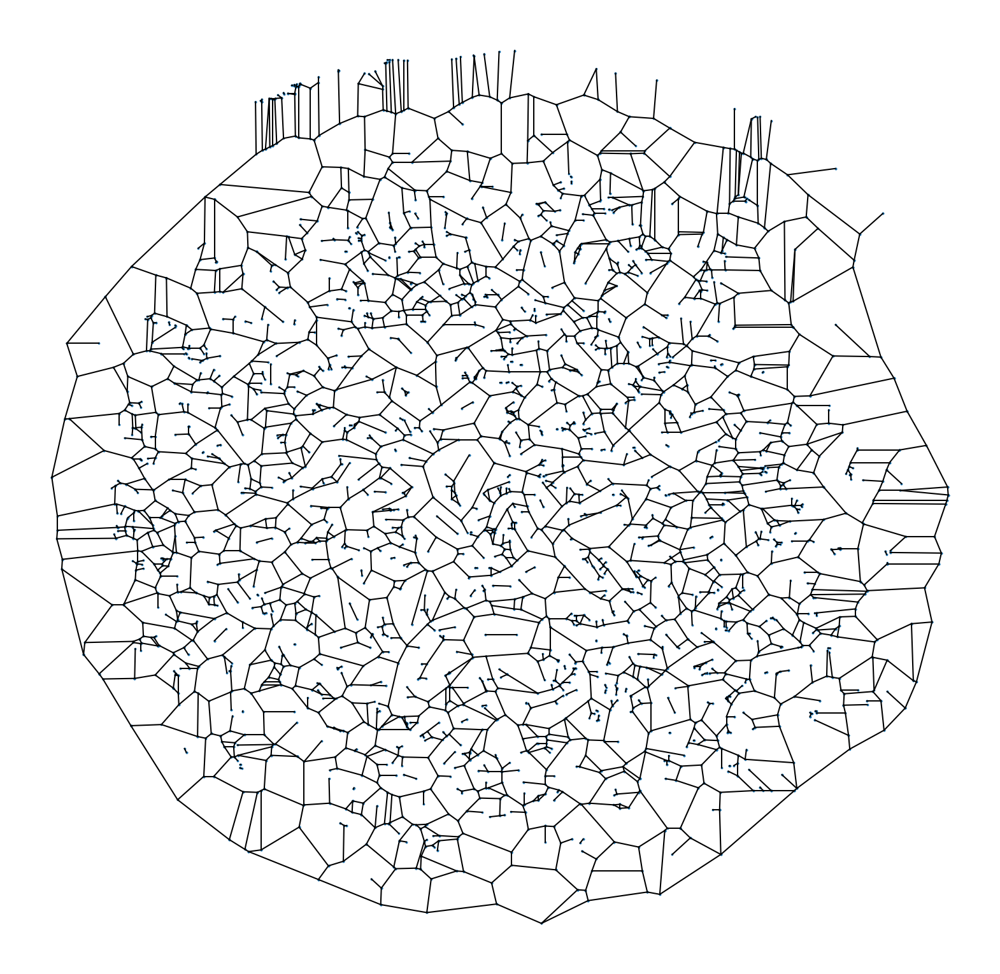

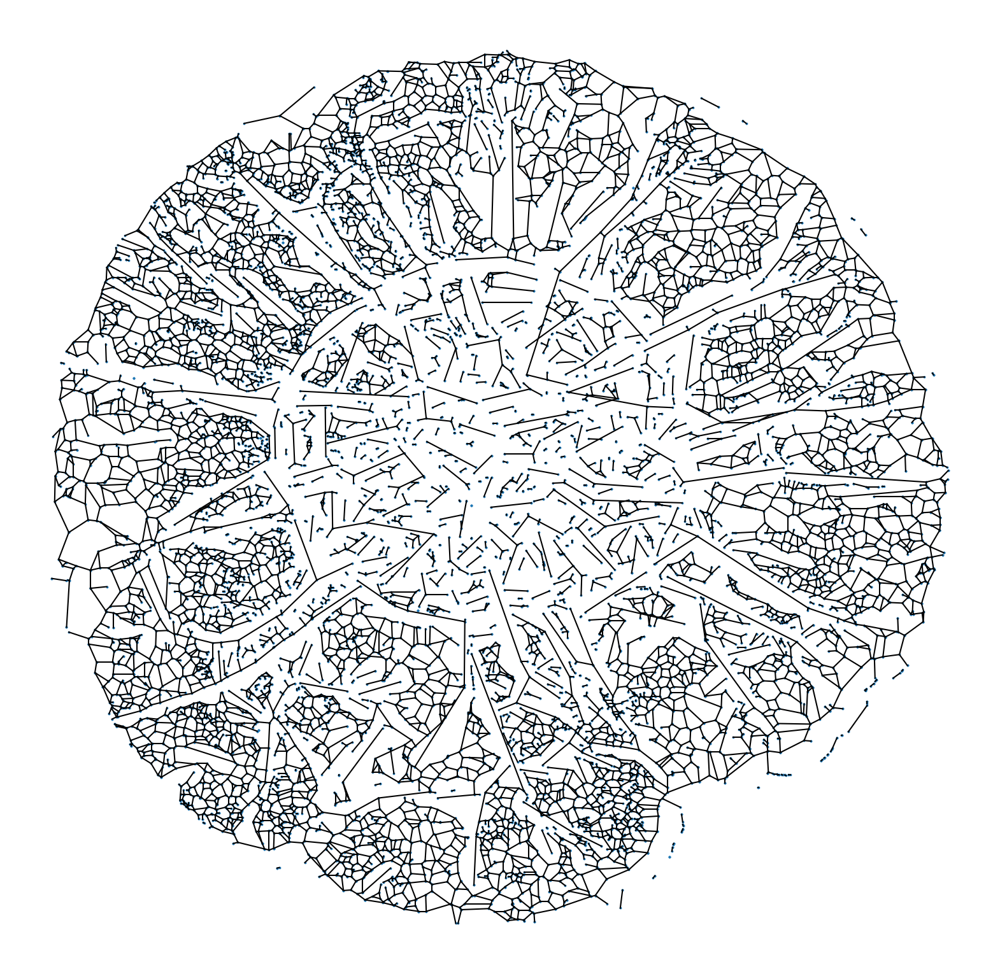

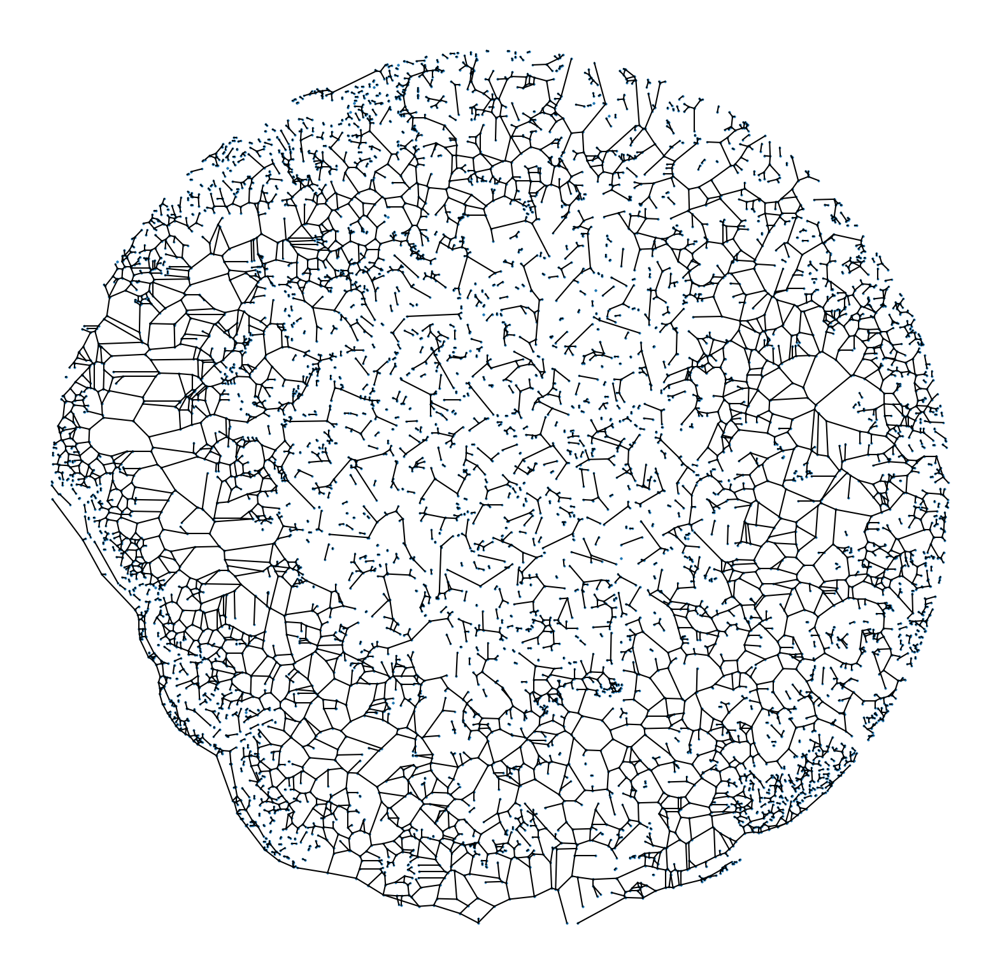

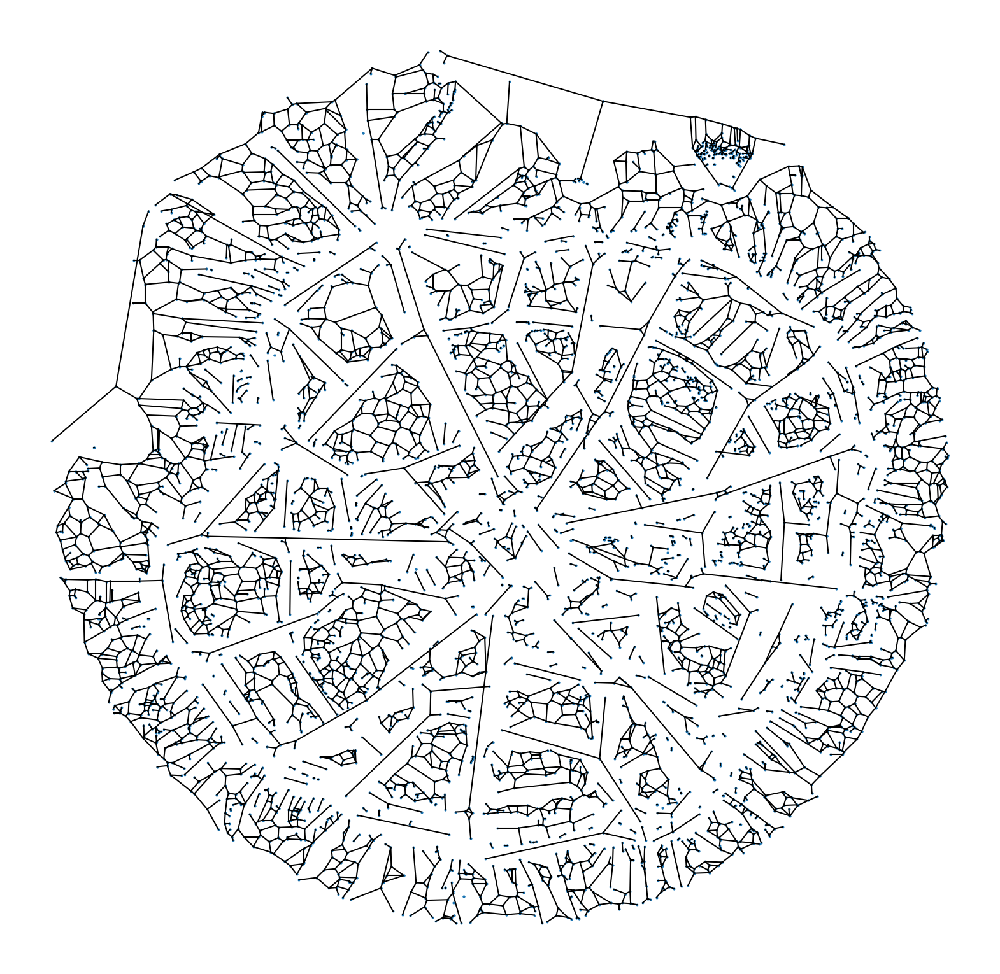

In [30]:
# draw all the networks

# open the text files
with os.scandir(nefi_text_directory_name) as text_networks:
    for text_network in text_networks:
        # do these steps ONLY if the number x is between 81 and 99, inclusive
        x = ''.join(filter(str.isdigit, text_network.name))
        if(int(x[1:]) >= 81 and int(x[1:]) <= 99):
            # read text files
            f = open(nefi_text_directory_name + text_network.name, "r")
            Lines = f.readlines()[3:]
            f.close()
            # reformat data
            A = []
            bracket = "{"
            for i in range(0, len(Lines)):
                if not bracket in Lines[i]:
                    node = Lines[i].partition("|")[0] # get the node
                    degree = int(Lines[i][-2]) # how many edges does this node have?
                    B = [0]*(degree+1)
                    B[0] = node
                    k = 1
                    for j in range(i + 1, i + degree + 1): # get all the edges of the node
                        edge = Lines[j].partition("|")[0]
                        B[k] = edge
                        k += 1
                    A.append(B)
            # draw the network
            figure(num=None, figsize=(20, 20), dpi=100)
            X = []
            Y = []
            for j in range(0, len(A)):
                C = A[j]
                k = C[0].find(',')
                x1 = int(C[0][1:].partition(",")[0]) # get the coordinates of the main node
                y1 = int(C[0][k+2:].partition(")")[0])
                X.append(x1)
                Y.append(y1)
                for i in range(1, len(C)):
                    k = C[i].find(',')
                    x2 = int(C[i][1:].partition(",")[0]) # get the coordinates of the destination node
                    y2 = int(C[i][k + 2:].partition(")")[0])
                    X.append(x2)
                    Y.append(y2)
                    plt.plot([x1,x2], [y1,y2],'k-')  # plot the edge
            plt.scatter(X, Y, 3) # plot EVERY node
            plt.axis('off')
            plt.savefig(python_network_directory_name + text_network.name[:-3] + 'png')

# close the text files
text_networks.close()

In [41]:
# rotate, crop, and overlay

A = []
B = []
C = []

# first save all the python network names and the original images
with os.scandir(python_network_directory_name) as py_networks:
    for py_network in py_networks:
        A.append(py_network.name)
py_networks.close()
        
with os.scandir(originalimg_directory_name) as original_imgs:
    for original_img in original_imgs:
        B.append(original_img.name)
original_imgs.close()

with os.scandir(overlay_directory_name) as py_networks:
    for py_network in py_networks:
        C.append(py_network.name)
py_networks.close()

print(len(C))

print(len(A))
print(len(B))
x = ''.join(filter(str.isdigit, A[0]))
print(x)
s = x[1:] + '.png'
print(s)

156
156
156
21
1.png


In [40]:
for net, bac in zip(A, B):
    # create image object
    img = Image.open(python_network_directory_name + net)
    # rotate image
    rotateImg1  = img.transpose(Image.ROTATE_90)
    rotateImg2 = rotateImg1.transpose(Image.ROTATE_90)
    rotateImg3 = rotateImg2.transpose(Image.ROTATE_90)
    # crop
    croppedImg = rotateImg3.crop((90, 60, 1920, 1960)) # left, upper, right, lower
    # rescale
    rescaledImg = croppedImg.resize((2000, 2000))
    # overlay
    background = Image.open(originalimg_directory_name + bac)
    overlay = rescaledImg
    background = background.convert("RGBA")
    overlay = overlay.convert("RGBA")
    new_img = Image.blend(background, overlay, 0.5)
    x = ''.join(filter(str.isdigit, net))
    newTitle = x[1:] + '.png'
    new_img.save(overlay_directory_name+ newTitle)

In [ ]:
# in the reformatting files part, add some random edges? that is, find the nearest 5 points, and draw an edge between them?
# should only happen if the degree of the node is tiny